In [1]:
%pip install langchain langchain_community
%pip install evaluate rouge_score bert-score requests pandas
%pip install torch torchvision torchaudio --index-url https://download.pytorch.org/whl/cu124
%pip install transformers ctransformers sentence_transformers
%pip install -U scikit-learn

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.
Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.
Defaulting to user installation because normal site-packages is not writeable
Looking in indexes: https://download.pytorch.org/whl/cu124
Note: you may need to restart the kernel to use updated packages.
Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.
Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


In [2]:
import requests

BASE_URL = "http://localhost:5032"

def send_message_to_server(user_id, message):
    """
    Sends a message to the server and retrieves the response.
    """
    url = f"{BASE_URL}/chat"
    payload = {
        "user_id": user_id,
        "message": message
    }
    response = requests.post(url, json=payload)
    response.raise_for_status()
    return response.json().get("response", "")

def create_user(name="Test User", emotion="Neutral", pronouns="They/Them"):
    """
    Create a new user on the server.
    """
    url = f"{BASE_URL}/user/create"
    payload = {
        "name": name,
        "emotion": emotion,
        "pronouns": pronouns
    }
    response = requests.post(url, json=payload)
    response.raise_for_status()
    return response.json()["id"]

def delete_user(user_id):
    """
    Delete a user from the server to free up resources.
    """
    url = f"{BASE_URL}/user/delete"
    payload = {"id": user_id}
    response = requests.post(url, json=payload)
    response.raise_for_status()

In [3]:
import logging
logging.getLogger("transformers").setLevel(logging.ERROR)

In [4]:
from sentence_transformers import SentenceTransformer
from sklearn.metrics.pairwise import cosine_similarity

# Load Sentence-BERT model
sbert_model = SentenceTransformer("all-MiniLM-L6-v2")

def calculate_similarity(expected, actual):
    """
    Calculate cosine similarity using Sentence-BERT embeddings.
    """
    expected_embedding = sbert_model.encode([expected])
    actual_embedding = sbert_model.encode([actual])
    return cosine_similarity(expected_embedding, actual_embedding)[0][0]


In [5]:
from bert_score import score

def calculate_bert_score(expected, actual):
    """
    Calculate BERTScore for expected and actual responses.
    """
    P, R, F1 = score([actual], [expected], lang="en", rescale_with_baseline=True)
    return P.mean().item(), R.mean().item(), F1.mean().item()


In [6]:
import os
import pandas as pd
from tqdm import tqdm  

# Dataset Evaluation
def evaluate_kaggle_datasets():
    print("evaluating kaggle dataset")
    new_csv_name = "kaggle-therapy-conversations.csv"

    destination_path = os.path.join(os.getcwd(), new_csv_name)
    kaggle_data = pd.read_csv(destination_path)

    shuffled_kaggle = kaggle_data.sample(frac=0.25, random_state=42).reset_index(drop=True)

    user_id = create_user()  # Create a new user for this evaluation

    results = []
    for _, row in tqdm(shuffled_kaggle.iterrows(), total=shuffled_kaggle.shape[0], desc="Processing rows"):

        input_text = row["Context"]
        expected_output = row["Response"]

        # Fetch server response
        actual_output = send_message_to_server(user_id, input_text)

        # Calculate metrics
        similarity = calculate_similarity(expected_output, actual_output)
        precision, recall, f1 = calculate_bert_score(expected_output, actual_output)

        # Append results
        result = {
            "input": input_text,
            "expected": expected_output,
            "actual": actual_output,
            "similarity": similarity,
            "bert_precision": precision,
            "bert_recall": recall,
            "bert_f1": f1
        }
        results.append(result)

    delete_user(user_id)  # Clean up the user after the test
    return pd.DataFrame(results)

evaluation_results = evaluate_kaggle_datasets()


evaluating kaggle dataset


Processing rows:   0%|          | 0/878 [00:00<?, ?it/s]Some weights of RobertaModel were not initialized from the model checkpoint at roberta-large and are newly initialized: ['roberta.pooler.dense.bias', 'roberta.pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
Processing rows:   0%|          | 1/878 [00:05<1:20:51,  5.53s/it]Some weights of RobertaModel were not initialized from the model checkpoint at roberta-large and are newly initialized: ['roberta.pooler.dense.bias', 'roberta.pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
Processing rows:   0%|          | 2/878 [00:09<1:05:30,  4.49s/it]Some weights of RobertaModel were not initialized from the model checkpoint at roberta-large and are newly initialized: ['roberta.pooler.dense.bias', 'roberta.pooler.dense.weight']
You should probably TRAIN this model on a down-

In [8]:
evaluation_results.to_csv('evaluation_results.csv', index=False)

) missing from font(s) DejaVu Sans.al\Temp\ipykernel_23116\3761175116.py:13: UserWarning: Glyph 13 (
  plt.tight_layout()
Font 'default' does not have a glyph for '\r' [U+d], substituting with a dummy symbol.
C:\Users\Sahil Malhotra\AppData\Local\Temp\ipykernel_23116\3761175116.py:13: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()
) missing from font(s) DejaVu Sans.al\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\LocalCache\local-packages\Python312\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 13 (
  fig.canvas.print_figure(bytes_io, **kw)
Font 'default' does not have a glyph for '\r' [U+d], substituting with a dummy symbol.


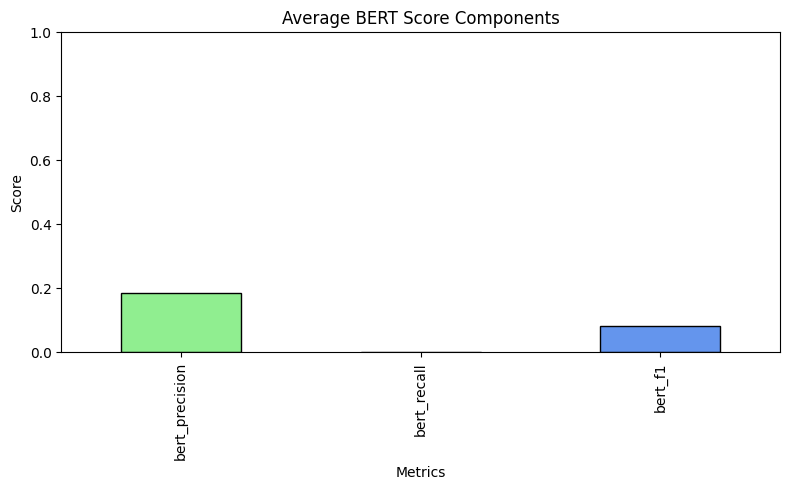

C:\Users\Sahil Malhotra\AppData\Local\Temp\ipykernel_23116\3761175116.py:39: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


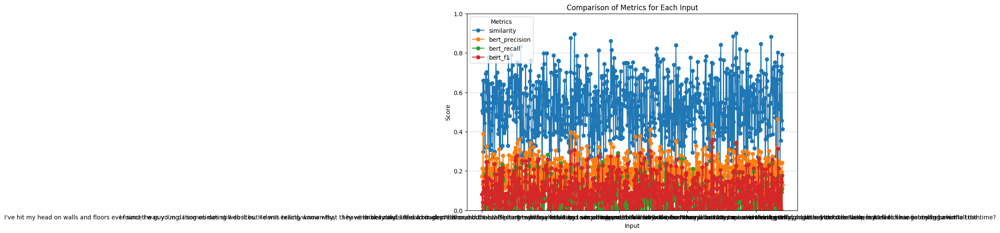

In [7]:
import matplotlib.pyplot as plt

df = evaluation_results

# Plot 1: Similarity vs Inputs
plt.figure(figsize=(8, 5))
plt.bar(df['input'], df['similarity'], color='skyblue', edgecolor='black')
plt.title('Cosine Similarity for Each Input')
plt.xlabel('Input')
plt.ylabel('Similarity')
plt.ylim(0, 1)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


# Plot 2: BERT Score Components (Precision, Recall, F1)
metrics = ['bert_precision', 'bert_recall', 'bert_f1']
df_metrics = df[metrics].mean()  # Average scores for all inputs

plt.figure(figsize=(8, 5))
df_metrics.plot(kind='bar', color=['lightgreen', 'orange', 'cornflowerblue'], edgecolor='black')
plt.title('Average BERT Score Components')
plt.xlabel('Metrics')
plt.ylabel('Score')
plt.ylim(0, 1)
plt.tight_layout()
plt.show()

# Plot 3: Combined View of Metrics per Input
df.plot(x='input', y=['similarity', 'bert_precision', 'bert_recall', 'bert_f1'],
        kind='line', marker='o', figsize=(10, 6))
plt.title('Comparison of Metrics for Each Input')
plt.xlabel('Input')
plt.ylabel('Score')
plt.ylim(0, 1)
plt.legend(title='Metrics')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()